###import libirares

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

###loading data set

In [2]:
#!/bin/bash
!kaggle datasets download kaggle/sf-salaries

'kaggle' is not recognized as an internal or external command,
operable program or batch file.


In [3]:
!unzip /content/sf-salaries.zip

'unzip' is not recognized as an internal or external command,
operable program or batch file.


In [4]:
df=pd.read_csv(r'C:\Users\ahmed\Downloads\EDA\sfsallary\datasets\Salaries.csv')

C:\Users\ahmed\AppData\Local\Temp\ipykernel_16612\3262892346.py:1: DtypeWarning: Columns (3,4,5,6,12) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv(r'C:\Users\ahmed\Downloads\EDA\sfsallary\datasets\Salaries.csv')


In [5]:
most=df['JobTitle'].value_counts().head(5).reset_index()

In [6]:
most

,JobTitle,count
0,Transit Operator,7036
1,Special Nurse,4389
2,Registered Nurse,3736
3,Public Svc Aide-Public Works,2518
4,Police Officer 3,2421


###EDA

In [5]:
df.head()

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status
0,1,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.0,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN
1,2,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN
2,3,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.6,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN
3,4,CHRISTOPHER CHONG,WIRE ROPE CABLE MAINTENANCE MECHANIC,77916.0,56120.71,198306.9,NaN,332343.61,332343.61,2011,NaN,San Francisco,NaN
4,5,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.6,9737.0,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 148654 entries, 0 to 148653
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Id                148654 non-null  int64  
 1   EmployeeName      148654 non-null  object 
 2   JobTitle          148654 non-null  object 
 3   BasePay           148049 non-null  object 
 4   OvertimePay       148654 non-null  object 
 5   OtherPay          148654 non-null  object 
 6   Benefits          112495 non-null  object 
 7   TotalPay          148654 non-null  float64
 8   TotalPayBenefits  148654 non-null  float64
 9   Year              148654 non-null  int64  
 10  Notes             0 non-null       float64
 11  Agency            148654 non-null  object 
 12  Status            38119 non-null   object 
dtypes: float64(3), int64(2), object(8)
memory usage: 14.7+ MB


there are columns data types should be converted to probr data typed

In [7]:
df.shape

(148654, 13)

In [8]:
df.isna().sum()

Id                       0
EmployeeName             0
JobTitle                 0
BasePay                605
OvertimePay              0
OtherPay                 0
Benefits             36159
TotalPay                 0
TotalPayBenefits         0
Year                     0
Notes               148654
Agency                   0
Status              110535
dtype: int64

##what i will do cleaning

  - [X] modify data types
  - [X] handling null values
  - [ ] check for outlaiers

In [9]:
#modifyng data types
coluns=["BasePay", "OvertimePay", "OtherPay"  ,"Benefits"]
for col in coluns:
  df[col]=pd.to_numeric(df[col],errors='coerce')

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 148654 entries, 0 to 148653
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Id                148654 non-null  int64  
 1   EmployeeName      148654 non-null  object 
 2   JobTitle          148654 non-null  object 
 3   BasePay           148045 non-null  float64
 4   OvertimePay       148650 non-null  float64
 5   OtherPay          148650 non-null  float64
 6   Benefits          112491 non-null  float64
 7   TotalPay          148654 non-null  float64
 8   TotalPayBenefits  148654 non-null  float64
 9   Year              148654 non-null  int64  
 10  Notes             0 non-null       float64
 11  Agency            148654 non-null  object 
 12  Status            38119 non-null   object 
dtypes: float64(7), int64(2), object(4)
memory usage: 14.7+ MB


##handling null values

In [11]:
df.isna().sum()

Id                       0
EmployeeName             0
JobTitle                 0
BasePay                609
OvertimePay              4
OtherPay                 4
Benefits             36163
TotalPay                 0
TotalPayBenefits         0
Year                     0
Notes               148654
Agency                   0
Status              110535
dtype: int64

drop notes and statues because they are not valuble

In [12]:
df.drop(['Notes','Status'],axis=1,inplace=True)

drop nulls in basepay because they are 609 not afect the data set

In [13]:
df.dropna(subset=['BasePay'],inplace=True)

check for if TotalPayBenefits = TotalPay +Benefits

In [14]:
(df['TotalPayBenefits'] == (df['TotalPay'] + (df['Benefits'].fillna(0)))).value_counts()


True     124742
False     23303
Name: count, dtype: int64

this shows that our asumption is true but investigate in  the false values why

In [15]:
df[(df['TotalPayBenefits']) != (df['TotalPay'] + df['Benefits'].fillna(0))]

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Agency
36159,36160,Gary Altenberg,"Lieutenant, Fire Suppression",128808.87,220909.48,13126.31,44430.12,362844.66,407274.78,2012,San Francisco
36161,36162,Khoa Trinh,Electronic Maintenance Tech,111921.00,146415.32,78057.41,53102.29,336393.73,389496.02,2012,San Francisco
36167,36168,John Goldberg,Captain 3,104404.00,0.00,245999.41,24287.23,350403.41,374690.64,2012,San Francisco
36169,36170,Brendan Ward,"Battlion Chief, Fire Suppressi",174822.47,118215.58,28845.78,49648.09,321883.83,371531.92,2012,San Francisco
36171,36172,Rudy Castellanos,"Battlion Chief, Fire Suppressi",176771.74,124413.13,15803.39,52320.90,316988.26,369309.16,2012,San Francisco
...,...,...,...,...,...,...,...,...,...,...,...
148582,148583,Eva M Crummett,Recreation Leader,51.60,0.00,0.00,0.52,51.60,52.12,2014,San Francisco
148596,148597,Rowena T Ignacio,Registered Nurse,0.00,0.00,33.55,6.91,33.55,40.46,2014,San Francisco
148600,148601,Kim L Evans,Recreation Leader,37.23,0.00,0.00,0.37,37.23,37.60,2014,San Francisco
148601,148602,Brieanna Mcfadden,Recreation Leader,34.88,0.00,0.00,0.35,34.88,35.23,2014,San Francisco


after seeing the data its support our assumption because also the false condition achive that TotalPayBenefits = TotalPay +Benefits

filling nulls in benfites with TotalPayBenefits = TotalPay +Benefits

In [16]:
df['Benefits'] = df['Benefits'].fillna(df['TotalPayBenefits'] - df['TotalPay'])

In [17]:
df.isna().sum()

Id                  0
EmployeeName        0
JobTitle            0
BasePay             0
OvertimePay         0
OtherPay            0
Benefits            0
TotalPay            0
TotalPayBenefits    0
Year                0
Agency              0
dtype: int64

In [18]:
df.head()

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Agency
0,1,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,0.0,567595.43,567595.43,2011,San Francisco
1,2,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,0.0,538909.28,538909.28,2011,San Francisco
2,3,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,0.0,335279.91,335279.91,2011,San Francisco
3,4,CHRISTOPHER CHONG,WIRE ROPE CABLE MAINTENANCE MECHANIC,77916.00,56120.71,198306.90,0.0,332343.61,332343.61,2011,San Francisco
4,5,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,0.0,326373.19,326373.19,2011,San Francisco


###check for outlayers

In [19]:
ncols=['BasePay','OvertimePay','OtherPay','Benefits','TotalPay','TotalPayBenefits']
for col in ncols:
  print(col)
  print(df[col].describe())

BasePay
count    148045.000000
mean      66325.448840
std       42764.635495
min        -166.010000
25%       33588.200000
50%       65007.450000
75%       94691.050000
max      319275.010000
Name: BasePay, dtype: float64
OvertimePay
count    148045.000000
mean       5086.740800
std       11473.181557
min          -0.010000
25%           0.000000
50%           0.000000
75%        4695.710000
max      245131.880000
Name: OvertimePay, dtype: float64
OtherPay
count    148045.000000
mean       3645.661408
std        8019.498636
min       -7058.590000
25%           0.000000
50%         817.170000
75%        4242.900000
max      400184.250000
Name: OtherPay, dtype: float64
Benefits
count    148045.000000
mean      18980.334019
std       17176.391332
min         -13.800000
25%           0.000000
50%       23468.340000
75%       33507.310000
max       96570.660000
Name: Benefits, dtype: float64
TotalPay
count    148045.000000
mean      75057.851048
std       50409.761170
min        -618.130000

it seem all has outlayers

notic negative values in base pay

In [20]:
#removing negative values
df = df[df['BasePay'] >= 0]


In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 148034 entries, 0 to 148653
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Id                148034 non-null  int64  
 1   EmployeeName      148034 non-null  object 
 2   JobTitle          148034 non-null  object 
 3   BasePay           148034 non-null  float64
 4   OvertimePay       148034 non-null  float64
 5   OtherPay          148034 non-null  float64
 6   Benefits          148034 non-null  float64
 7   TotalPay          148034 non-null  float64
 8   TotalPayBenefits  148034 non-null  float64
 9   Year              148034 non-null  int64  
 10  Agency            148034 non-null  object 
dtypes: float64(6), int64(2), object(3)
memory usage: 13.6+ MB


29609 people take more than the 80%

box plot all numerc columns to check out laiers

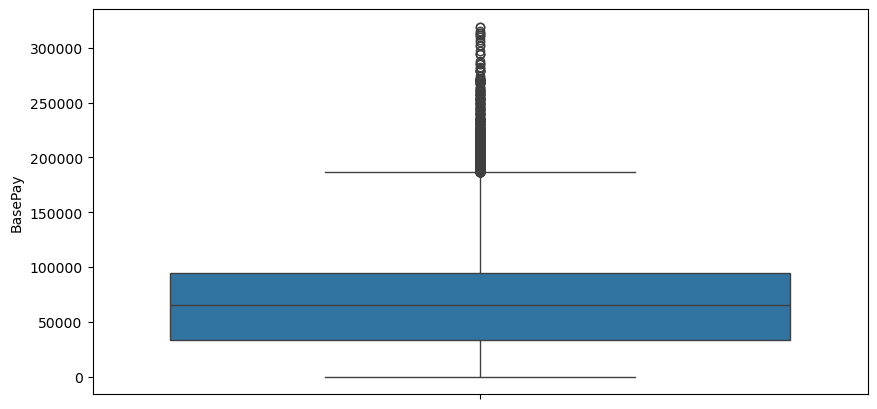

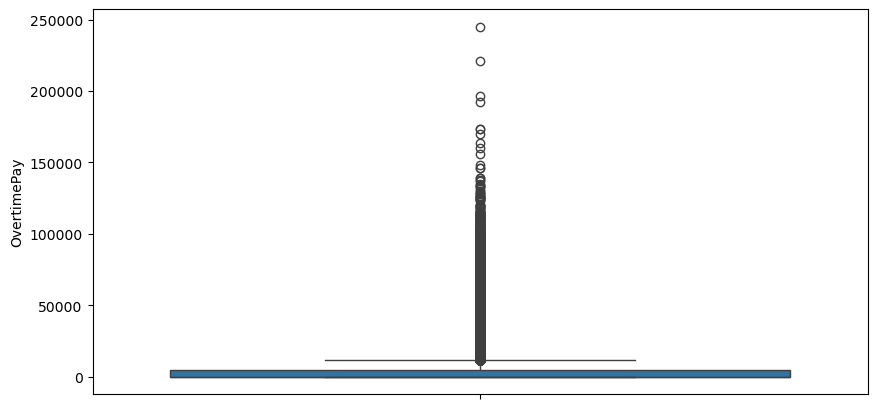

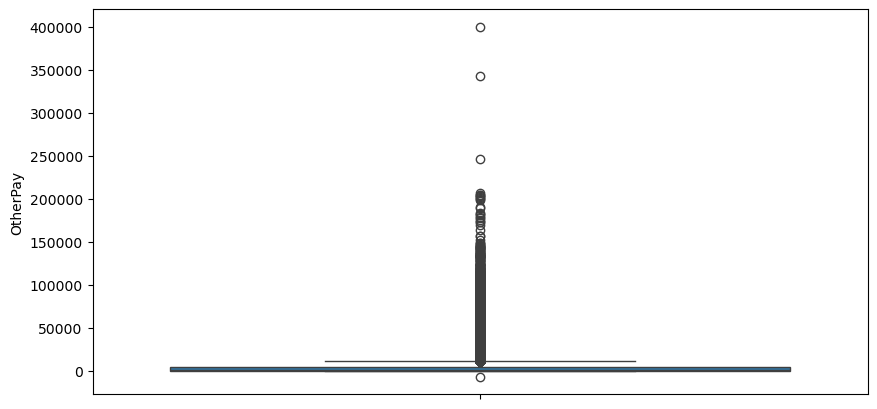

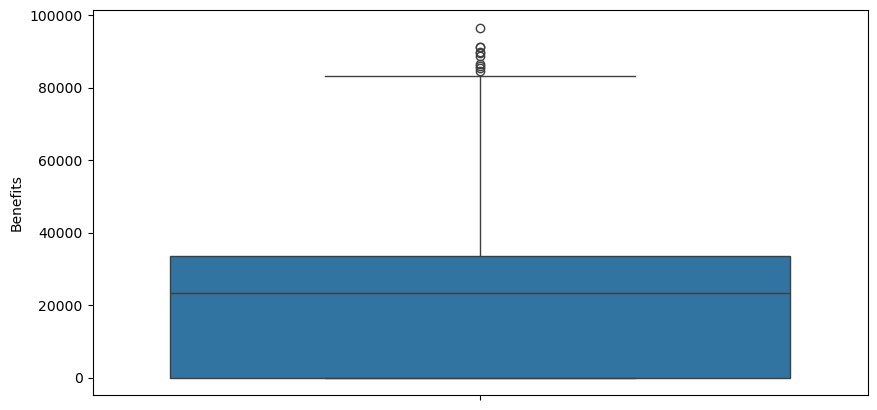

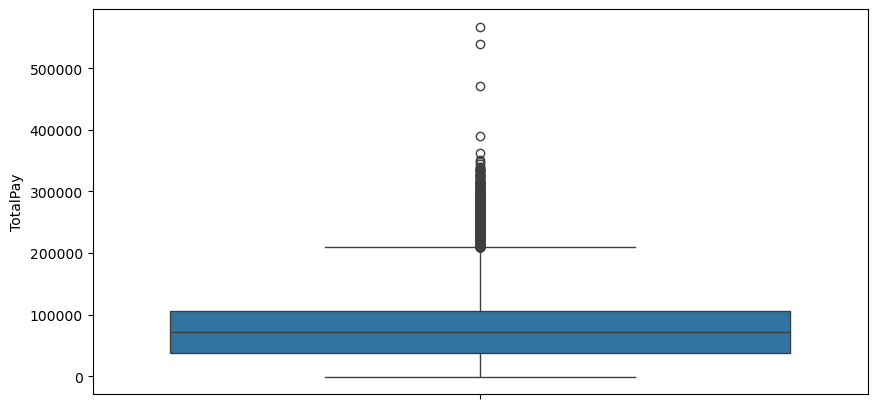

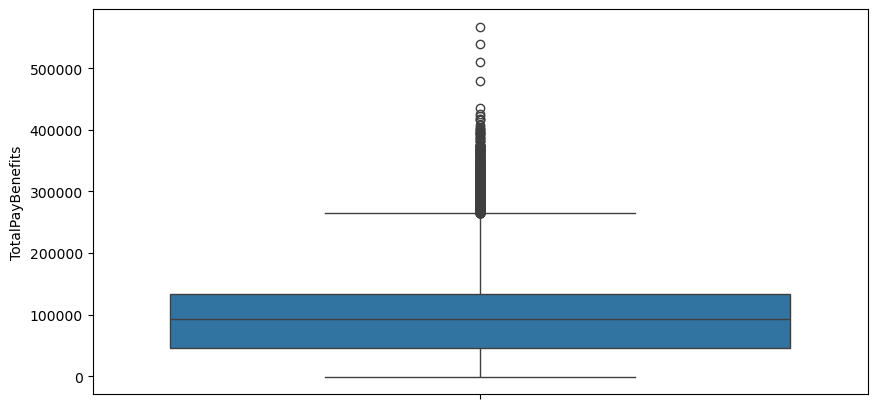

In [22]:
for col in ncols:
  plt.figure(figsize=(10,5))
  sns.boxplot(df[col])
  #sns.stripplot(df[col])
  plt.show()


In [23]:
z_scores = stats.zscore(df[ncols])

# Convert Z-scores to a DataFrame for easier filtering
z_scores_df = pd.DataFrame(z_scores, columns=ncols)

# Keep rows where all specified column Z-scores are below the threshold (e.g., 3)
df_clean = df[(stats.zscore(df[ncols]).abs() < 3).all(axis=1)]

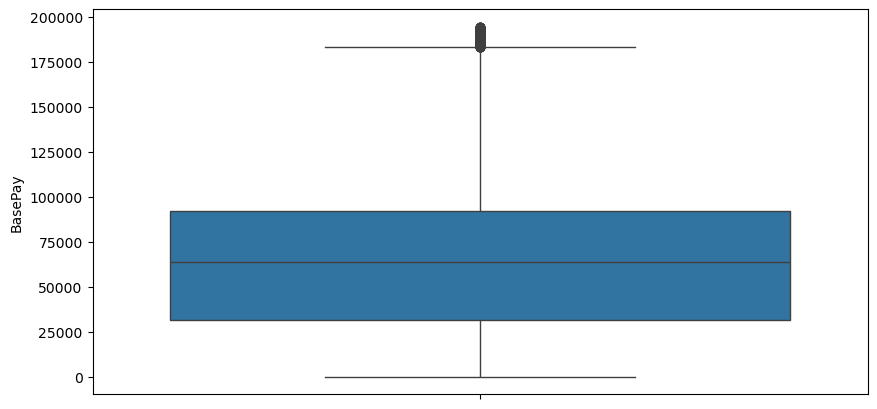

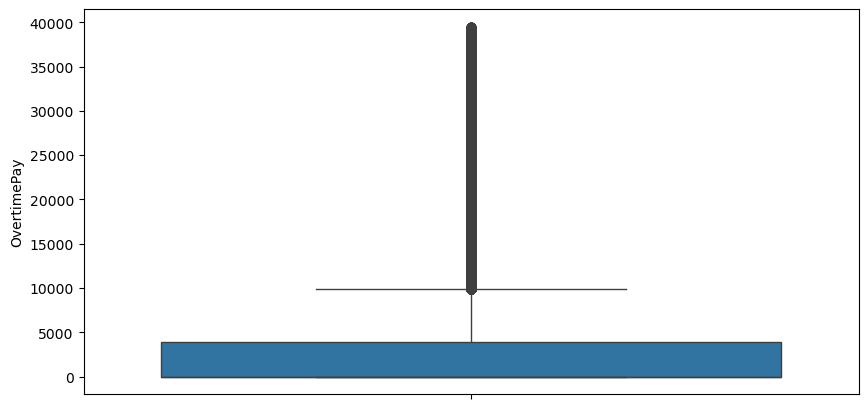

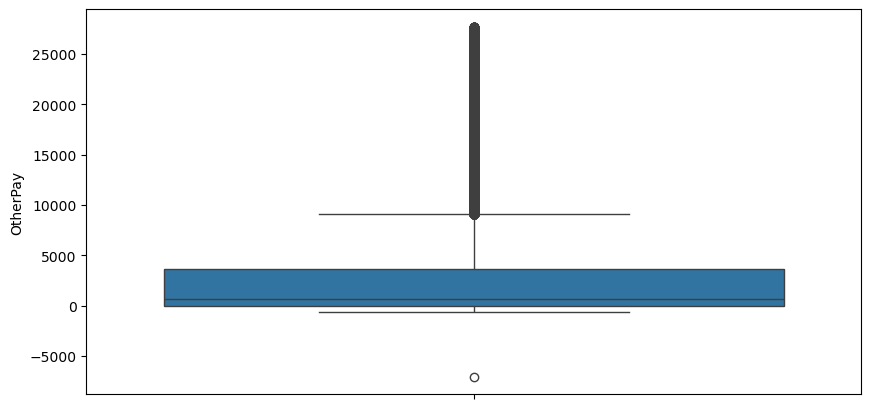

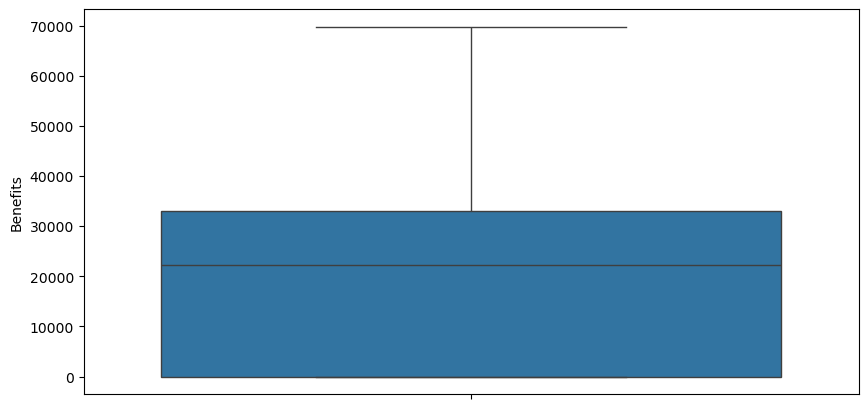

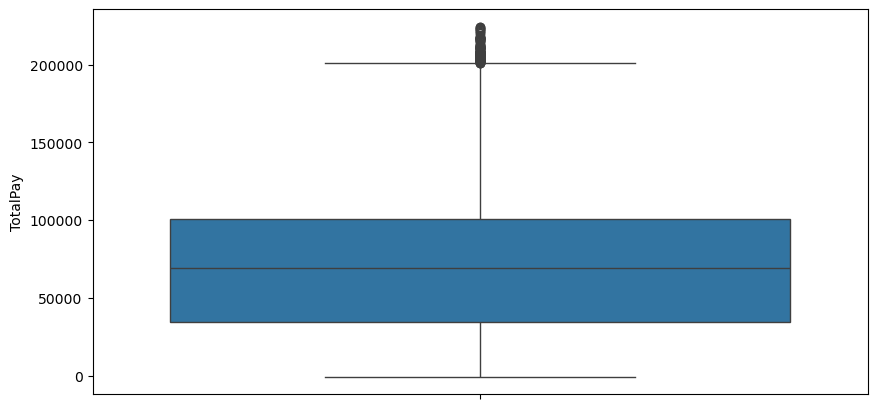

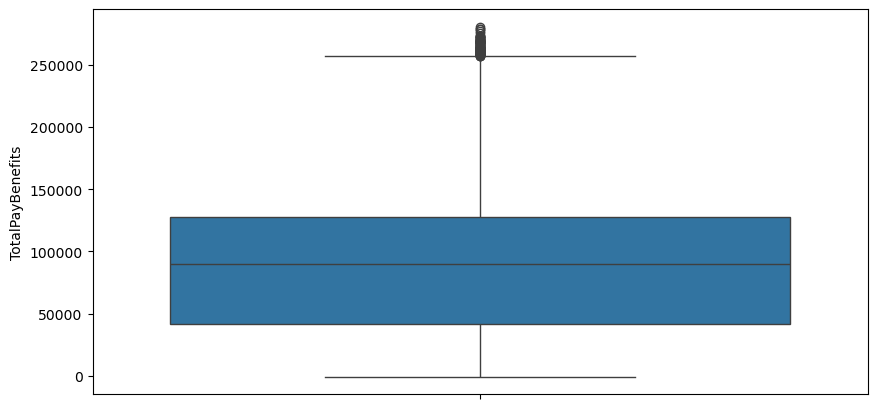

In [24]:
for col in ncols:
  plt.figure(figsize=(10,5))
  sns.boxplot(df_clean[col])
  #sns.stripplot(df_clean[col])
  plt.show()


In [25]:
df_clean.shape

(142179, 11)

handle outliers in basepay

```
# This is formatted as code
```



In [26]:
df_clean[df_clean['BasePay']>df_clean['BasePay'].quantile(0.99)].shape

(1420, 11)

In [27]:
df_clean=df_clean[df_clean['BasePay']<df_clean['BasePay'].quantile(0.99)]

<Axes: ylabel='BasePay'>

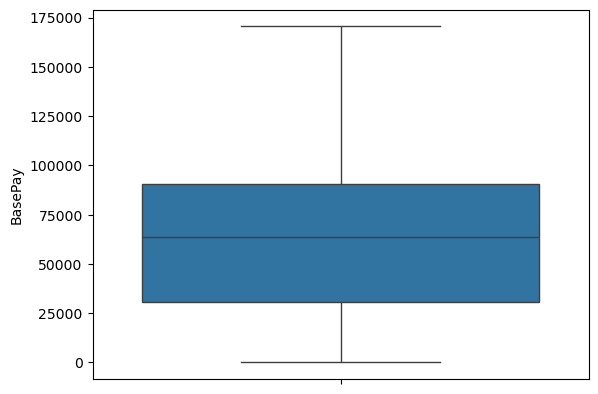

In [28]:
sns.boxplot(df_clean['BasePay'])

handle outliers in TotalPay


In [29]:
df_clean[df_clean['TotalPay']>df_clean['TotalPay'].quantile(0.99)].shape

(1408, 11)

In [30]:
df_clean=df_clean[df_clean['TotalPay']<df_clean['TotalPay'].quantile(0.99)]

<Axes: ylabel='TotalPay'>

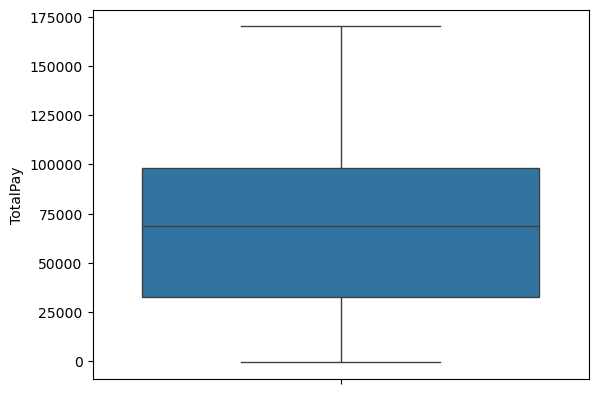

In [31]:
sns.boxplot(df_clean['TotalPay'])

handle outliers in TotalPay

In [32]:
df_clean[df_clean['TotalPayBenefits']>df_clean['TotalPayBenefits'].quantile(0.99)].shape

(1394, 11)

In [33]:
df_clean=df_clean[df_clean['TotalPayBenefits']<df_clean['TotalPayBenefits'].quantile(0.99)]

<Axes: ylabel='TotalPayBenefits'>

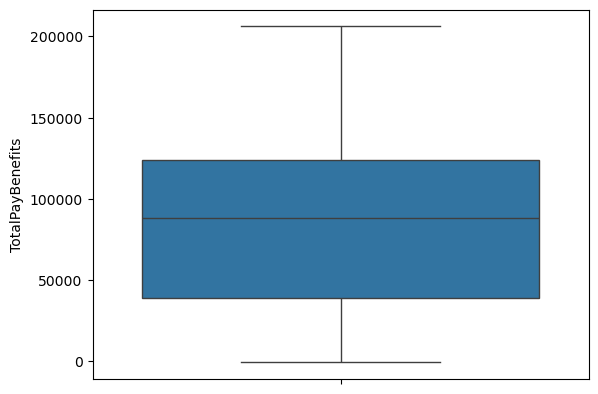

In [34]:
sns.boxplot(df_clean['TotalPayBenefits'])

###Doing som EDA

In [35]:
df.describe()

,Id,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year
count,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000
mean,74192.777112,66330.383796,5087.109033,3645.932307,18981.744115,75063.425136,94045.169251,2012.520691
std,42950.079107,42762.392041,11473.528281,8019.735008,17176.250496,50407.486340,62680.570137,1.119422
min,1.000000,0.000000,-0.010000,-7058.590000,-13.800000,-618.130000,-618.130000,2011.000000
25%,37009.250000,33599.432500,0.000000,0.000000,0.000000,36980.992500,45097.250000,2012.000000
50%,74028.500000,65010.265000,0.000000,817.435000,23471.440000,71648.415000,92680.350000,2013.000000
75%,111641.750000,94691.057500,4696.352500,4243.190000,33508.237500,106028.542500,133091.185000,2014.000000
max,148654.000000,319275.010000,245131.880000,400184.250000,96570.660000,567595.430000,567595.430000,2014.000000


top paid jobs

In [36]:
df.groupby('JobTitle')['TotalPay'].max().sort_values(ascending=False).head(10)

JobTitle
GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY    567595.43
CAPTAIN III (POLICE DEPARTMENT)                   538909.28
Deputy Chief 3                                    471952.64
Asst Med Examiner                                 390111.98
Lieutenant, Fire Suppression                      362844.66
Captain 3                                         350403.41
Battalion Chief, Fire Suppress                    347102.32
Chief Investment Officer                          339653.70
Chief of Police                                   339282.07
EMT/Paramedic/Firefighter                         337204.86
Name: TotalPay, dtype: float64

top paid persons

In [37]:
df.groupby('EmployeeName')['TotalPay'].max().sort_values(ascending=False).head(10)

EmployeeName
NATHANIEL FORD          567595.43
GARY JIMENEZ            538909.28
David Shinn             471952.64
Amy P Hart              390111.98
Gary Altenberg          362844.66
John Goldberg           350403.41
Samson  Lai             347102.32
Ellen G Moffatt         344187.46
William J Coaker Jr.    339653.70
Gregory P Suhr          339282.07
Name: TotalPay, dtype: float64

In [38]:
df.sort_values(by='TotalPay',ascending=False).head(10)

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Agency
0,1,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,0.00,567595.43,567595.43,2011,San Francisco
1,2,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,0.00,538909.28,538909.28,2011,San Francisco
110531,110532,David Shinn,Deputy Chief 3,129150.01,0.00,342802.63,38780.04,471952.64,510732.68,2014,San Francisco
110532,110533,Amy P Hart,Asst Med Examiner,318835.49,10712.95,60563.54,89540.23,390111.98,479652.21,2014,San Francisco
36159,36160,Gary Altenberg,"Lieutenant, Fire Suppression",128808.87,220909.48,13126.31,44430.12,362844.66,407274.78,2012,San Francisco
36167,36168,John Goldberg,Captain 3,104404.00,0.00,245999.41,24287.23,350403.41,374690.64,2012,San Francisco
72927,72928,Samson Lai,"Battalion Chief, Fire Suppress",186236.42,131217.63,29648.27,57064.95,347102.32,404167.27,2013,San Francisco
110536,110537,Ellen G Moffatt,Asst Med Examiner,270222.04,6009.22,67956.20,71580.48,344187.46,415767.94,2014,San Francisco
110533,110534,William J Coaker Jr.,Chief Investment Officer,257340.00,0.00,82313.70,96570.66,339653.70,436224.36,2014,San Francisco
72925,72926,Gregory P Suhr,Chief of Police,319275.01,0.00,20007.06,86533.21,339282.07,425815.28,2013,San Francisco


most common jobs

In [39]:
df['JobTitle'].value_counts().head(5)

JobTitle
Transit Operator                6975
Special Nurse                   4382
Registered Nurse                3725
Public Svc Aide-Public Works    2514
Police Officer 3                2411
Name: count, dtype: int64

least common

In [40]:
df['JobTitle'].value_counts().tail(10)

JobTitle
COURT AD RESOLUTION COORDINATOR          1
ROOFER SUPERVISOR I                      1
MEDIA PRODUCTION SUPERVISOR              1
SENIOR EMPLOYEE ASSISTANCE COUNSELOR     1
MEDIA TRAINING SPECIALIST                1
PRINCIPAL INVESTIGATOR, TAX COLLECTOR    1
BUILDING SERVICES TECHNICIAN             1
TRIAL DELAY REDUCTION COORDINATOR        1
POWERHOUSE ELECTRICIAN SUPERVISOR II     1
Cashier 3                                1
Name: count, dtype: int64

num of jobs by one person

In [41]:
sum(df['JobTitle'].value_counts()==1)

237

salary and year

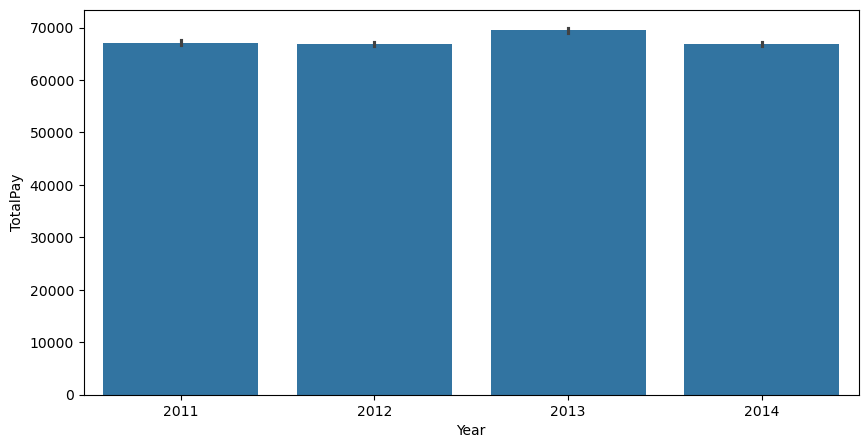

In [42]:
plt.figure(figsize=(10,5))
sns.barplot(x='Year',y='TotalPay',data=df_clean)
plt.show()

In [43]:
df.groupby('Year')['TotalPay'].mean()

Year
2011    71744.103871
2012    74135.429698
2013    78808.285041
2014    75471.836912
Name: TotalPay, dtype: float64

In [44]:
df_clean['Agency'].unique()

array(['San Francisco'], dtype=object)

only one agency

In [45]:
df_clean.drop_duplicates(inplace=True)

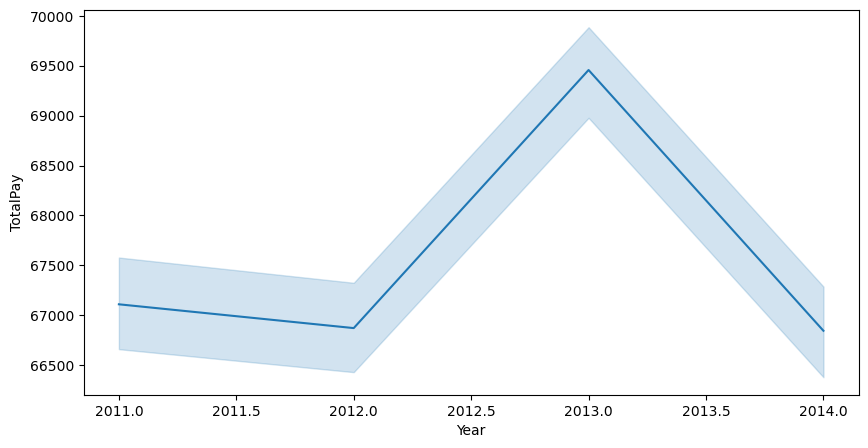

In [46]:
plt.figure(figsize=(10,5))
sns.lineplot(x='Year',y='TotalPay',data=df_clean)
plt.show()


In [47]:
df_clean.head(10)

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Agency
979,980,EUGENE CLENDINEN,MANAGER VIII,161479.27,0.00,8750.10,0.0,170229.37,170229.37,2011,San Francisco
982,983,CHARLES MC COY,"LIEUTENANT, FIRE DEPARTMENT",123105.00,31227.51,15842.22,0.0,170174.73,170174.73,2011,San Francisco
983,984,MICHAEL HASTEY,FIRE FIGHTER PARAMEDIC,122405.00,32171.52,15551.55,0.0,170128.07,170128.07,2011,San Francisco
986,987,KENNETH LOMBARDI,"CAPTAIN, FIRE SUPPRESSION",135103.40,23598.47,11377.28,0.0,170079.15,170079.15,2011,San Francisco
988,989,DOUGLAS PRICE-HANSON,PHYSICIAN SPECIALIST,159511.95,0.00,10513.63,0.0,170025.58,170025.58,2011,San Francisco
989,990,SUSAN OBATA,SUPERVISING PHYSICIAN SPECIALIST,169941.65,0.00,0.00,0.0,169941.65,169941.65,2011,San Francisco
991,992,LOUIS ESPINDA,LIEUTENANT III (POLICE DEPARTMENT),149050.78,6220.38,14638.50,0.0,169909.66,169909.66,2011,San Francisco
993,994,GRACE SALUD,NURSE MANAGER,156312.00,0.00,13587.12,0.0,169899.12,169899.12,2011,San Francisco
995,996,ANTIONETTE GRIFFIN,CLINICAL NURSE SPECIALIST,169572.08,0.00,250.00,0.0,169822.08,169822.08,2011,San Francisco
996,997,KATHERINE MAH,CLINICAL NURSE SPECIALIST,169572.06,0.00,250.00,0.0,169822.06,169822.06,2011,San Francisco


###making machine learning model

##feature selctions

drop none value like name , agency because its only one value
drop id

In [48]:
df_clean.drop(['Id','Agency','EmployeeName'],axis=1,inplace=True)

<Axes: >

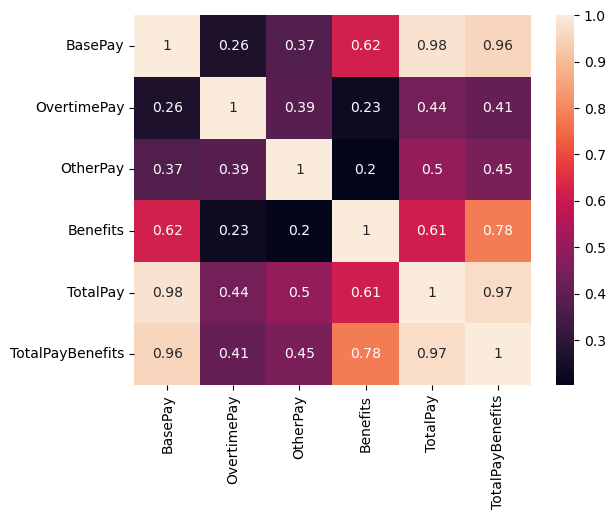

In [49]:
sns.heatmap(df_clean[ncols].corr(),annot=True)

drop totalpaywithbenfites

In [50]:
df_clean.drop('TotalPayBenefits',axis=1,inplace=True)

handling texts on job title

In [51]:
df_clean['JobTitle'] = df_clean['JobTitle'].str.lower()


In [52]:
#removing punctuwation
df_clean['JobTitle'] = df_clean['JobTitle'].str.replace(r'[^\w\s]', '', regex=True)


In [53]:
df_clean['JobTitle'] = df_clean['JobTitle'].str.strip()


In [54]:
df_clean['JobTitle'].nunique()

1564

In [55]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
df_clean['JobTitle'] = label_encoder.fit_transform(df_clean['JobTitle'])

using linear regerssion model

In [56]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df_clean), columns=df_clean.columns)

In [57]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

model=LinearRegression()

In [58]:
x=df_clean.drop(['BasePay'],axis=1)
y=df_clean['BasePay']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.25, random_state=42)

In [59]:
model.fit(X_train,y_train)

LinearRegression()

In [60]:
model.score(X_test,y_test)

1.0

evaluating model

In [61]:
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

In [62]:
print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 3.7286052533555205e-21
R-squared: 1.0


In [63]:
df_clean.head()

,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,Year
979,834,161479.27,0.00,8750.10,0.0,170229.37,2011
982,786,123105.00,31227.51,15842.22,0.0,170174.73,2011
983,573,122405.00,32171.52,15551.55,0.0,170128.07,2011
986,220,135103.40,23598.47,11377.28,0.0,170079.15,2011
988,990,159511.95,0.00,10513.63,0.0,170025.58,2011


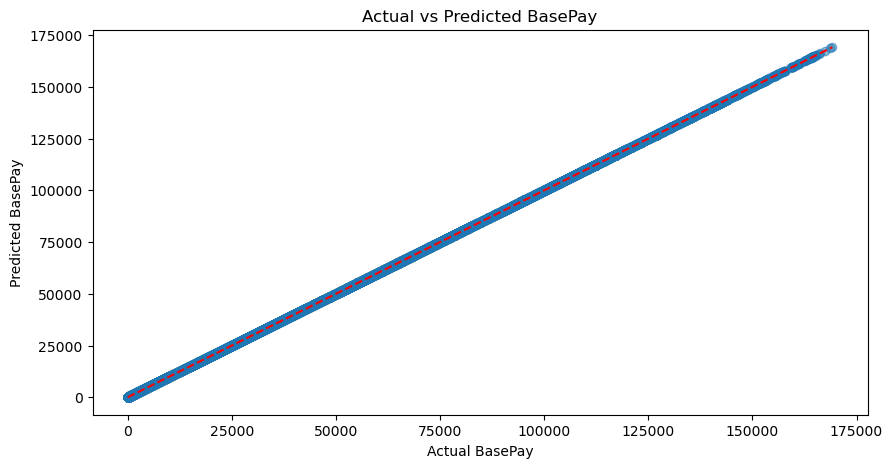

In [64]:
plt.figure(figsize=(10, 5))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.xlabel("Actual BasePay")
plt.ylabel("Predicted BasePay")
plt.title("Actual vs Predicted BasePay")
plt.plot([y_test.min(), y_test.max()], [y_pred.min(), y_pred.max()], 'r--')
plt.show()


In [65]:
df.head()

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Agency
0,1,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,0.0,567595.43,567595.43,2011,San Francisco
1,2,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,0.0,538909.28,538909.28,2011,San Francisco
2,3,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,0.0,335279.91,335279.91,2011,San Francisco
3,4,CHRISTOPHER CHONG,WIRE ROPE CABLE MAINTENANCE MECHANIC,77916.00,56120.71,198306.90,0.0,332343.61,332343.61,2011,San Francisco
4,5,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,0.0,326373.19,326373.19,2011,San Francisco


In [66]:
import plotly.express as px

In [68]:
df.isna().sum()

Id                  0
EmployeeName        0
JobTitle            0
BasePay             0
OvertimePay         0
OtherPay            0
Benefits            0
TotalPay            0
TotalPayBenefits    0
Year                0
Agency              0
dtype: int64

In [69]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 148034 entries, 0 to 148653
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Id                148034 non-null  int64  
 1   EmployeeName      148034 non-null  object 
 2   JobTitle          148034 non-null  object 
 3   BasePay           148034 non-null  float64
 4   OvertimePay       148034 non-null  float64
 5   OtherPay          148034 non-null  float64
 6   Benefits          148034 non-null  float64
 7   TotalPay          148034 non-null  float64
 8   TotalPayBenefits  148034 non-null  float64
 9   Year              148034 non-null  int64  
 10  Agency            148034 non-null  object 
dtypes: float64(6), int64(2), object(3)
memory usage: 13.6+ MB


In [71]:
df.describe()

,Id,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year
count,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000,148034.000000
mean,74192.777112,66330.383796,5087.109033,3645.932307,18981.744115,75063.425136,94045.169251,2012.520691
std,42950.079107,42762.392041,11473.528281,8019.735008,17176.250496,50407.486340,62680.570137,1.119422
min,1.000000,0.000000,-0.010000,-7058.590000,-13.800000,-618.130000,-618.130000,2011.000000
25%,37009.250000,33599.432500,0.000000,0.000000,0.000000,36980.992500,45097.250000,2012.000000
50%,74028.500000,65010.265000,0.000000,817.435000,23471.440000,71648.415000,92680.350000,2013.000000
75%,111641.750000,94691.057500,4696.352500,4243.190000,33508.237500,106028.542500,133091.185000,2014.000000
max,148654.000000,319275.010000,245131.880000,400184.250000,96570.660000,567595.430000,567595.430000,2014.000000


In [11]:
df=df[df['TotalPay']>0]

In [9]:
import plotly.express as px

In [13]:
fig = px.scatter(
    df,
    x='TotalPay',
    y='BasePay',
    title=None,
    labels={"TotalPay":"mm","BasePay":"kk"},
    color='Year',
    size='TotalPayBenefits',
    hover_data=['EmployeeName', 'JobTitle'],
    trendline='ols',
    facet_col=None,
    facet_row=None
)
fig.show()


In [81]:
gg=df_c.groupby('Year')['TotalPay'].mean().reset_index()

In [91]:
fig=px.line(gg,x='Year',y="TotalPay",markers=True,color=None,text="TotalPay")
fig.show()

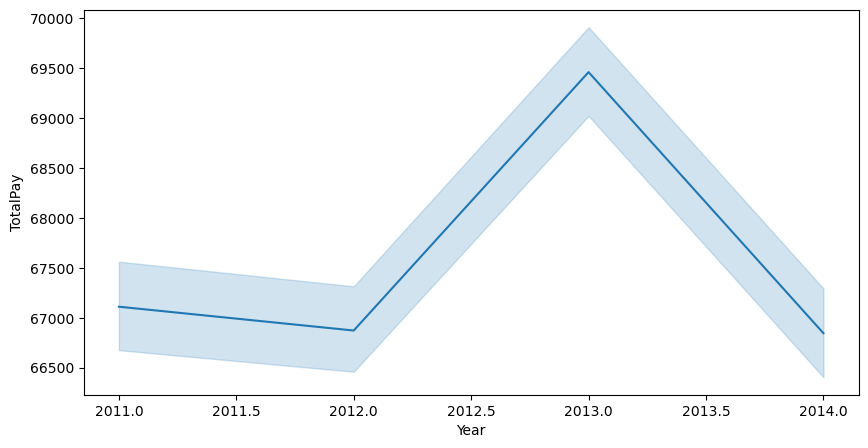

In [79]:
plt.figure(figsize=(10,5))
sns.lineplot(x='Year',y='TotalPay',data=df_clean)
plt.show()


In [92]:
fig=px.funnel_area(gg,names='Year',values="TotalPay")
fig.show()

In [95]:
df = px.data.gapminder()
fig = px.line(df, x="year", y="pop", color="continent",markers=True,height=600)
fig.show()

In [ ]:
import plotly.express as px

df = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.e6")
fig = px.bar(df, y='pop', x='country', text_auto='.2s',
            )
fig.show()

In [98]:
fig=px.pie(gg,names='Year',values="TotalPay")
fig.show()

In [100]:
fig=px.pie(gg,names='Year',values="TotalPay",hole=0.4)
fig.show()

In [101]:
import plotly.express as px
df = px.data.tips()
fig = px.sunburst(df, path=['day', 'time', 'sex'], values='total_bill')
fig.show()

In [102]:
import plotly.express as px
df = px.data.tips()
fig = px.box(df, y="total_bill")
fig.show()

In [106]:
import plotly.express as px
df = px.data.tips()
fig = px.box(df, y="total_bill",points="all")
fig.show()

In [103]:
import plotly.express as px
df = px.data.tips()
fig = px.box(df, x="time", y="total_bill")
fig.show()


In [104]:
import plotly.express as px
df = px.data.tips()
fig = px.box(df, x="time", y="total_bill", points="all")
fig.show()